<a href="https://colab.research.google.com/github/Jackline-Jebet/Msc-Financial-Engineering_Quant-Finance-Projects/blob/main/Financial-Data/Financial_Engineering_Tick_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

**2. Examples of Tick Data¶**

For this reason, we will be exploring:

1.) BTC/USDT tick-by-tick trades downloaded from Kraken exchange: https://support.kraken.com/hc/en-us/articles/360047543791-Downloadable-historical-market-data-time-and-sales-

2.) RVN/USDT tick-by-tick trades downloaded from Binance exchange: https://data.binance.vision/

3.) AGLJ/ZAR Level 1 Data with trades downloaded from: https://data.mendeley.com/datasets/4rrk89c3b2/2

Due to VM restrictions, a very small portion of the data above is sampled for teaching purposes. But you are encouraged to download large tick-by-tick datasets locally in order to face firsthand the technical difficulties of dealing with big data.

Tick-by-tick trade data consists of the following columns:

Symbol: the unique identifier of the financial instrument.

Timestamp: the exact time when the transaction was recorded (granularity ranges from second to nanosecond).

Price: the executed price of the trade.

Volume: The number of units traded.

Trade Direction (optional): indicates whether the trade was buyer-initiated or seller-initiated.

The most important aspect of tick data, which is granularity, allows us to undertake:

Studying intraday volatility.

Understanding price formation more thoroughly.

Backtesting of high-frequency (HF) trading strategies.

Assessing market impact to determine scaling a strategy.

Analyzing the transaction costs of a strategy.

Exploring execution strategies.

Detecting market manipulation (can be used by regulatory authorities).

Aggregation to time-based or volume-based bars.


In [ ]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

Saving XBTUSDT.csv to XBTUSDT.csv
User uploaded file "XBTUSDT.csv" with length 26929614 bytes


In [ ]:
# Load the data, dataset (1) - BTC/USD from Kraken
btc_usdt = pd.read_csv("XBTUSDT.csv", names=['UNIX_time', 'price', 'volume'])
btc_usdt.head()

,UNIX_time,price,volume
0,1704067200,42289.2,0.013922
1,1704067202,42289.2,0.000100
2,1704067240,42293.3,0.000100
3,1704067332,42295.0,0.418000
4,1704067332,42295.0,0.054826


The Unix Timestamps can be represented with different levels of precision:

10 digits: Represents seconds (e.g., 1688169604).

13 digits: Includes milliseconds (e.g., 1688169604123).

16 digits: Includes microseconds (e.g., 1688169604123456).

19 digits: Includes nanoseconds (e.g., 1688169604123456789).

In the dataset (1), we can count 10 digits for the UNIX_time column. Therefore, the precision is given in seconds, and this is the only thing we need to know in order to transform Unix time into human-readable datetime.

In [ ]:
# Convert the UNIX timestamp to human readable datetime. Check the argument unit='s' to make sure the timestamp is in seconds.
btc_usdt['timestamp'] = pd.to_datetime(btc_usdt['UNIX_time'], unit='s')
btc_usdt.set_index('timestamp', inplace=True) # Set the timestamp as the index
btc_usdt.head()

,UNIX_time,price,volume
timestamp,,,
2024-01-01 00:00:00,1704067200,42289.2,0.013922
2024-01-01 00:00:02,1704067202,42289.2,0.000100
2024-01-01 00:00:40,1704067240,42293.3,0.000100
2024-01-01 00:02:12,1704067332,42295.0,0.418000
2024-01-01 00:02:12,1704067332,42295.0,0.054826


**3. Visualizing Tick Trade Data**

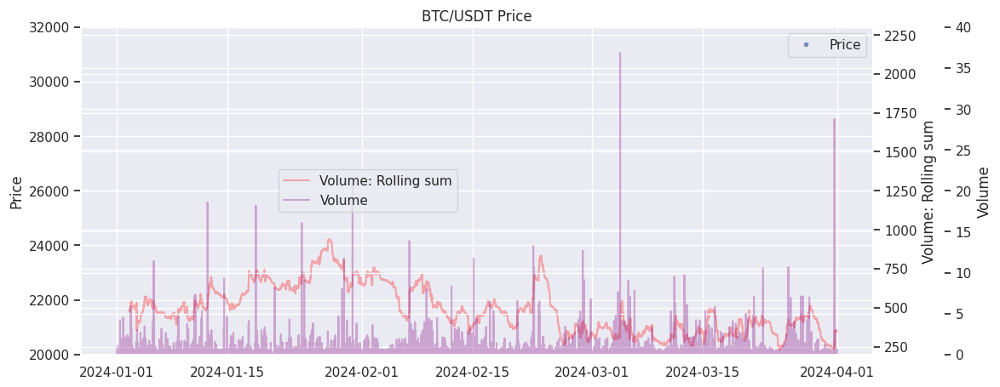

In [ ]:
#Figure 1
fig, ax = plt.subplots(figsize=(12, 5))
ax.scatter(btc_usdt.index, btc_usdt['price'], s = 0.001, alpha=0.4)
ax.set_ylabel('Price')
ax.set_title('BTC/USDT Price')
ax.set_ylim(20000, 32000)

custom_legend = plt.Line2D([0], [0], linestyle="none", marker='o', color='b', markersize=3, alpha = 0.7, label='Price') # Creating a custom legend
ax.legend(handles=[custom_legend], loc='upper right')

ax2 = ax.twinx() # Create a second y-axis
ax2.plot(btc_usdt.index, btc_usdt['volume'].rolling(10000).sum(), color='red', label='Volume: Rolling sum', alpha=0.3)
ax2.set_ylabel('Volume: Rolling sum')
ax2.set_ylim(200, 2300)

ax3 = ax.twinx() # Create a third y-axis
ax3.plot(btc_usdt.index, btc_usdt['volume'], color='purple', label='Volume', alpha=0.3)
ax3.set_ylabel('Volume')
ax3.set_ylim(0, 40)
ax3.spines['right'].set_position(('outward', 60))

fig.legend(bbox_to_anchor=(0.5,0.56)) # Adjust the legend position
plt.show()

We must note that datasets (1) and (2) are retrieved directly from the exchanges where they were produced; thus, we expect no missing inputs. That does not mean there are no errors in the data!

Let's explore our dataset:

In [ ]:
between_trades_interval = btc_usdt['UNIX_time'].diff().dropna() # Calculate the trade duration
print("Summary Statistics \n\n", between_trades_interval.describe(), "\n\n") # Get the summary statistics of the trade duration
print("10 Largest trade durations \n\n", between_trades_interval.sort_values(ascending=False).head(10)) # Get the top 10 largest durations between trades

Summary Statistics 

 count    792046.000000
mean          9.926694
std          39.004167
min           0.000000
25%           0.000000
50%           0.000000
75%           7.000000
max       20190.000000
Name: UNIX_time, dtype: float64 


10 Largest trade durations 

 timestamp
2024-01-20 21:35:44    20190.0
2024-01-08 11:41:11    13267.0
2024-01-21 02:35:16     1230.0
2024-01-18 03:54:49     1156.0
2024-01-21 05:48:47      968.0
2024-02-26 02:24:50      944.0
2024-01-07 07:24:03      878.0
2024-01-21 02:13:18      872.0
2024-01-28 02:27:53      832.0
2024-01-23 05:15:41      825.0
Name: UNIX_time, dtype: float64


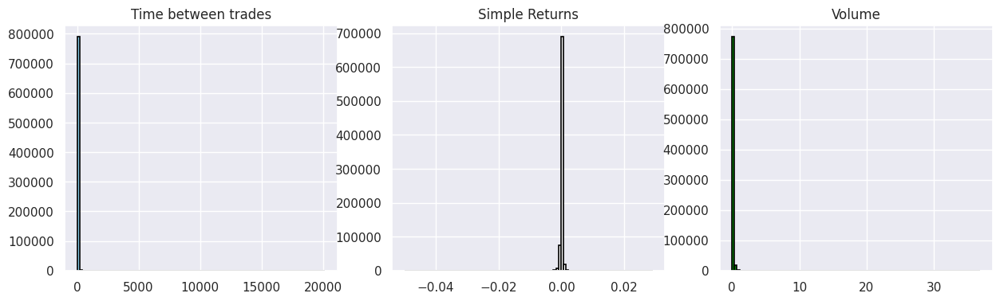

In [ ]:
# Let's check the distribution of volume, simple returns and intervals between trades.

#Figure 2
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4))
ax1.hist(between_trades_interval, bins=100, color='skyblue', edgecolor='black', linewidth=1.2)
ax1.set_title("Time between trades")
ax2.hist(btc_usdt['price'].pct_change().dropna(), bins=100, color='white', edgecolor='black', linewidth=1.2)
ax2.set_title("Simple Returns")
ax3.hist(btc_usdt['volume'], bins=100, color='green', edgecolor='black', linewidth=1.2)
ax3.set_title("Volume")
plt.show()

The above results hint at three important facts:

There are several trades that happened at the same second. Those trades could be a single trade that was divided in many trades at the moment of execution as the volume at the best bid or ask was not enough to cover the trade volume in that instant. These trades are called split transactions.

There are several trades that did not result in a price change.

A lot of trades seem to have very low volume.

In [ ]:
boolean_array_is_duplicate = btc_usdt['UNIX_time'].duplicated(keep=False) # Check for duplicates
sum_of_duplicates = boolean_array_is_duplicate.sum() # Sum the duplicates
print("The number of trades that occured at the same second with at least one more trade, is: ",sum_of_duplicates)
print("The percentage of these trades to the number of all trades, is: ",round(sum_of_duplicates / len(btc_usdt) * 100, 2), "%")
print("The percentage of the volume of these trades to the entire volume, is: ",round(((boolean_array_is_duplicate * btc_usdt['volume']).sum() / btc_usdt['volume'].sum() )* 100, 2), "%")

The number of trades that occured at the same second with at least one more trade, is:  544277
The percentage of these trades to the number of all trades, is:  68.72 %
The percentage of the volume of these trades to the entire volume, is:  87.43 %


We will assume that these trades are split transactions. After some simple aggregations, the histograms plotted above look very different:

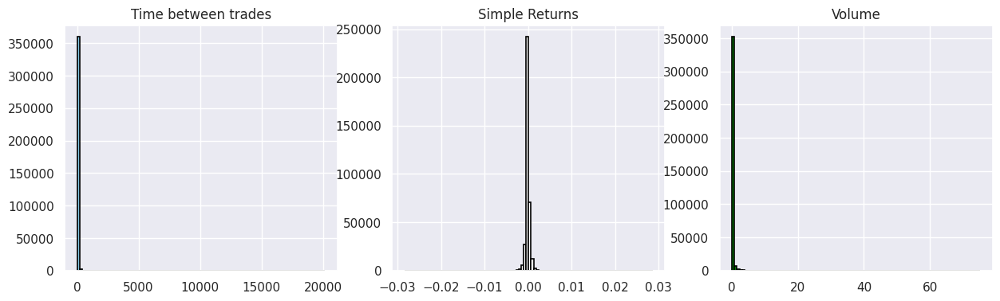

In [ ]:
# Figure 3
aggr_dataset_1 = pd.DataFrame()
aggr_dataset_1['UNIX_time'] = btc_usdt['UNIX_time'].groupby(btc_usdt['UNIX_time']).first() # Group the UNIX timestamp by the first timestamp
aggr_dataset_1['volume'] = btc_usdt['volume'].groupby(btc_usdt['UNIX_time']).sum() # Aggregate the volume by the UNIX timestamp
aggr_dataset_1['price'] = (btc_usdt['price'] * btc_usdt['volume']).groupby(btc_usdt['UNIX_time']).sum() / aggr_dataset_1['volume'] # Final price as VWAP of the split transaction
aggr_dataset_1.index = btc_usdt.index.drop_duplicates() # Drop the duplicates from the index

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4))
ax1.hist(aggr_dataset_1['UNIX_time'].diff().dropna(), bins=100, color='skyblue', edgecolor='black', linewidth=1.2)
ax1.set_title("Time between trades")
ax2.hist(aggr_dataset_1['price'].pct_change().dropna(),bins=100, color='white', edgecolor='black', linewidth=1.2)
ax2.set_title("Simple Returns")
ax3.hist(aggr_dataset_1['volume'], bins=100, color='green', edgecolor='black', linewidth=1.2)
ax3.set_title("Volume")
plt.show()

At this point, one could continue the workflow with a returns analysis, an order flow imbalance (OFI), volatility estimation, liquidity measure, etc. Since these datasets will be used for tick-data presentation and not analysis, we will move to dataset (2), and an introductory workflow will be presented with dataset (3).

**4. Including the Trade Direction**

In [ ]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

Saving RVNUSDT-trades-2023-07.csv to RVNUSDT-trades-2023-07.csv
User uploaded file "RVNUSDT-trades-2023-07.csv" with length 28709076 bytes


In [ ]:
import glob

# Load the data, dataset (2) - RVN/USDT
list_of_files = glob.glob('RVNUSDT*') # List the RVNUSDT files in the directory
column_names = ['id', 'price', 'qty', 'base_qty', 'UNIX_time', 'is_buyer_maker', 'is_best_match'] # Column names
rvn_usdt = pd.concat([pd.read_csv(file, names=column_names) for file in list_of_files], ignore_index=True, axis = 0) # Concatenate the files
rvn_usdt.sort_values('UNIX_time', inplace=True) # Sort the values by time
rvn_usdt.head(5)

,id,price,qty,base_qty,UNIX_time,is_buyer_maker,is_best_match
0,55888285,0.02003,10000.0,200.300000,1688169611321,False,True
2,55888287,0.02003,4347.2,87.074416,1688169611324,False,True
1,55888286,0.02003,8962.5,179.518875,1688169611324,False,True
3,55888288,0.02003,2585.3,51.783559,1688169611324,False,True
6,55888291,0.02003,4347.2,87.074416,1688169611324,False,True


In [ ]:
# We will check whether the additional columns hold any information before we omit them in order to handle a smaller dataset, which will be less taxing on ram.

print("Number of duplicate entries: ", rvn_usdt['id'].duplicated().sum()) # Check for duplicates
print("Number of entries that were not executed at the best possible price: ", (~rvn_usdt['is_best_match']).sum()) # Check for best match
print("Can the base_qty be derived from the qty and price?: ", np.isclose(rvn_usdt['price'] * rvn_usdt['qty'], rvn_usdt['base_qty'], atol=1e-05).all()) # Check if the base quantity can be derived from the quantity
print("Due to the results above, we can drop the columns 'id', 'is_best_match' and 'base_qty' \n\n")

rvn_usdt = rvn_usdt.drop(columns=['id', 'is_best_match', 'base_qty']) # Drop the unnecessary columns
rvn_usdt['timestamp'] = pd.to_datetime(rvn_usdt['UNIX_time'], unit='ms') # Convert the UNIX timestamp to human readable datetime. Check the argument unit='ms' to make sure the timestamp is in milliseconds.
rvn_usdt.set_index('timestamp', inplace=True) # Set the timestamp as the index
rvn_usdt.head()


Number of duplicate entries:  0
Number of entries that were not executed at the best possible price:  0
Can the base_qty be derived from the qty and price?:  True
Due to the results above, we can drop the columns 'id', 'is_best_match' and 'base_qty' 




,price,qty,UNIX_time,is_buyer_maker
timestamp,,,,
2023-07-01 00:00:11.321,0.02003,10000.0,1688169611321,False
2023-07-01 00:00:11.324,0.02003,4347.2,1688169611324,False
2023-07-01 00:00:11.324,0.02003,8962.5,1688169611324,False
2023-07-01 00:00:11.324,0.02003,2585.3,1688169611324,False
2023-07-01 00:00:11.324,0.02003,4347.2,1688169611324,False


**5. Manipulating Tick Data**

From now and on, with "buying volume" or "selling volume," we will refer to the volume of the trades whose initiator/taker was the buyer or seller, respectively. To understand how to use the added information, we will present the data manipulations that are essential for calculating the buying and selling volume.

The buying volume is:  1513449327.4000003
The selling volume is:  1655002312.4000006


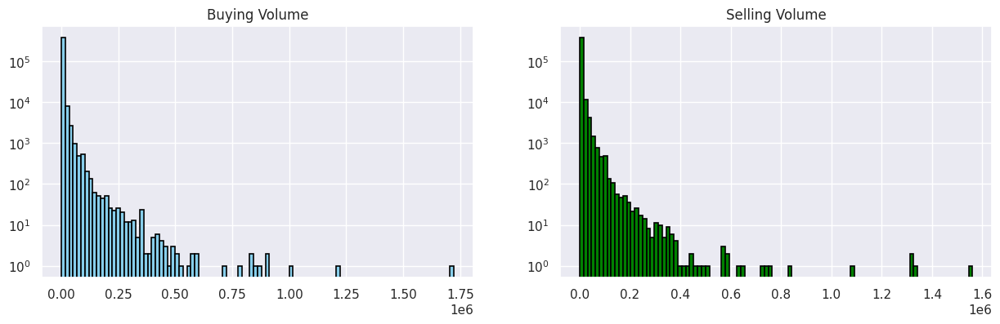

In [ ]:
# Figure 4
buying_volume = rvn_usdt['qty'] * (~rvn_usdt['is_buyer_maker']) # An array that contains the buying volume
selling_volume = rvn_usdt['qty'] * rvn_usdt['is_buyer_maker'] # An array that contains the selling volume

print("The buying volume is: ", buying_volume.sum()) # Calculate the buying volume
print("The selling volume is: ", selling_volume.sum()) # Calculate the selling volume

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 4))
ax1.hist(buying_volume, log = True, bins=100, color='skyblue', edgecolor='black', linewidth=1.2)
ax1.set_title("Buying Volume")
ax2.hist(selling_volume, log = True, bins=100, color='green', edgecolor='black', linewidth=1.2)
ax2.set_title("Selling Volume")
plt.show()

**Exercise 1**

In the histogram above, we have used the argument log = True in order to transform the  𝑦
  axis in log scale. To see why, plot the histograms of the buying and selling volume with log = False. Furthermore, let's distinguish between transforming the  𝑦
  axis for visualization purposes and transforming the data itself, using the natural logarithm. Create the two histograms again with log = False, but use the np.log function to transform the buying and selling volume: np.log(buying_volume[buying_volume > 1]). Do the same for the histograms presented in Figure 3. Explain the differences

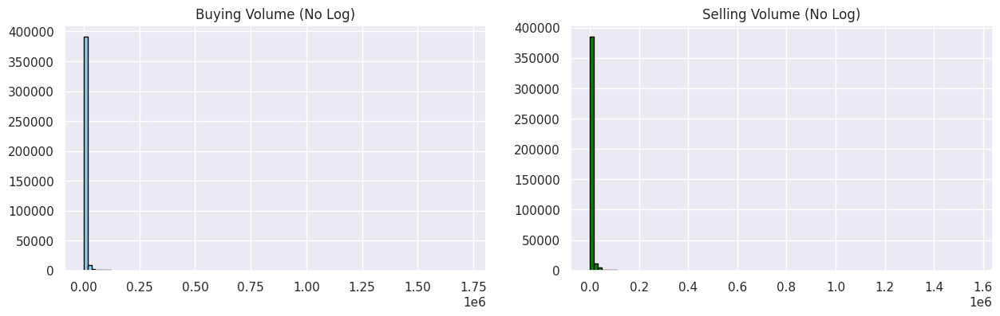

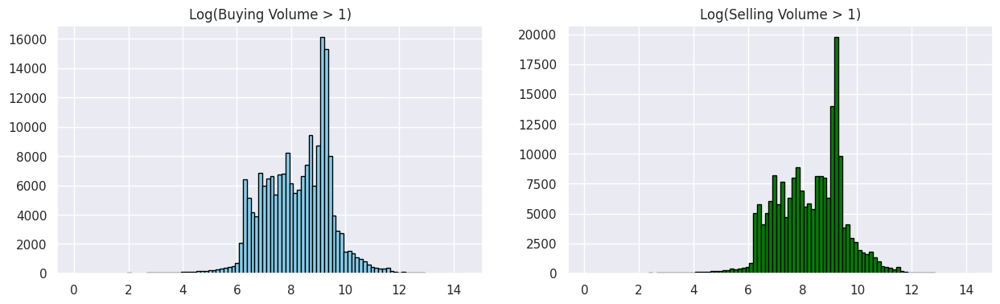

In [ ]:
# Step 1: Plot Histograms for RVN/USDT (Dataset 2)

# Load RVN/USDT data (assuming similar structure to provided code)
rvn_usdt = pd.concat([pd.read_csv(file, names=['id', 'price', 'qty', 'base_qty', 'UNIX_time', 'is_buyer_maker', 'is_best_match'])
                      for file in glob.glob('RVNUSDT*')], ignore_index=True)
rvn_usdt.sort_values('UNIX_time', inplace=True)
rvn_usdt['timestamp'] = pd.to_datetime(rvn_usdt['UNIX_time'], unit='ms')
rvn_usdt.set_index('timestamp', inplace=True)

buying_volume = rvn_usdt['qty'] * (~rvn_usdt['is_buyer_maker'])
selling_volume = rvn_usdt['qty'] * rvn_usdt['is_buyer_maker']

# Plot with log=False
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 4))
ax1.hist(buying_volume, bins=100, color='skyblue', edgecolor='black')
ax1.set_title("Buying Volume (No Log)")
ax2.hist(selling_volume, bins=100, color='green', edgecolor='black')
ax2.set_title("Selling Volume (No Log)")
plt.show()

# Plot with np.log and log=False
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 4))
ax1.hist(np.log(buying_volume[buying_volume > 1]), bins=100, color='skyblue', edgecolor='black')
ax1.set_title("Log(Buying Volume > 1)")
ax2.hist(np.log(selling_volume[selling_volume > 1]), bins=100, color='green', edgecolor='black')
ax2.set_title("Log(Selling Volume > 1)")
plt.show()

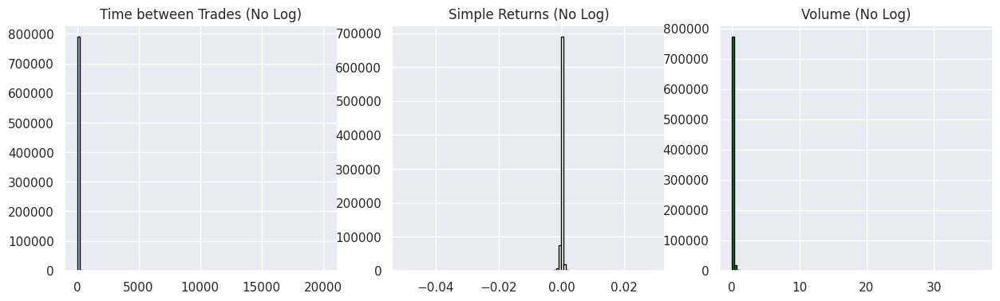

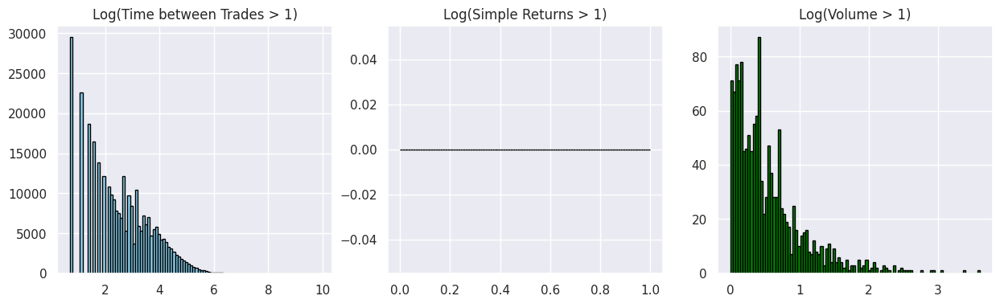

In [ ]:
# Step 2: Plot Histograms for BTC/USDT (Figure 3, Dataset 1):

# Load BTC/USDT data
btc_usdt = pd.read_csv("XBTUSDT.csv", names=['UNIX_time', 'price', 'volume'])
btc_usdt['timestamp'] = pd.to_datetime(btc_usdt['UNIX_time'], unit='s')
btc_usdt.set_index('timestamp', inplace=True)
between_trades_interval = btc_usdt['UNIX_time'].diff().dropna()
returns = btc_usdt['price'].pct_change().dropna()
volume = btc_usdt['volume']

# Plot with log=False
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4))
ax1.hist(between_trades_interval, bins=100, color='skyblue', edgecolor='black')
ax1.set_title("Time between Trades (No Log)")
ax2.hist(returns, bins=100, color='white', edgecolor='black')
ax2.set_title("Simple Returns (No Log)")
ax3.hist(volume, bins=100, color='green', edgecolor='black')
ax3.set_title("Volume (No Log)")
plt.show()

# Plot with np.log and log=False
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4))
ax1.hist(np.log(between_trades_interval[between_trades_interval > 1]), bins=100, color='skyblue', edgecolor='black')
ax1.set_title("Log(Time between Trades > 1)")
ax2.hist(np.log(returns[returns > 1]), bins=100, color='white', edgecolor='black')
ax2.set_title("Log(Simple Returns > 1)")
ax3.hist(np.log(volume[volume > 1]), bins=100, color='green', edgecolor='black')
ax3.set_title("Log(Volume > 1)")
plt.show()

**Step 3: Explain Differences: **

**Log Scale on Y-Axis (log=True):**

Compresses the y-axis to emphasize extreme values (e.g., large volumes or rare trade intervals).

- Useful for visualizing skewed distributions (common in tick data) where most values are small, but a few are very large.

**Example:** In Figure 4, the log scale highlights the frequency of large buying/selling volumes, which would be obscured without it.

- **Applying np.log to Data:**

Transforms the data itself, compressing the range of values (e.g., large volumes become smaller numbers).

Only applies to values > 1 to avoid undefined logs (log(0) or log(negative) is invalid).

Results in a more normal-like distribution, reducing skewness but potentially losing interpretability (e.g., log(volume) is not in original units).

**Differences:**
Y-Axis Log Scale: Changes visualization only, keeping data in original units. Better for understanding raw distributions.
Data Log Transformation: Alters the data, making distributions less skewed but harder to interpret in financial terms (e.g., log(volume) vs. actual volume).

**Figure 3 (BTC/USDT):**

Time between trades and volume are highly skewed, so log=True reveals rare large intervals/volumes. Log-transforming data compresses these extremes, making the histogram look more normal but less intuitive for trade analysis.

**Figure 4 (RVN/USDT):**

Similar effect; log scale highlights large buy/sell volumes, while log-transformed data smooths the distribution but changes the scale.

**Answer:**

Using log=True adjusts the y-axis to highlight extreme values in skewed distributions, while np.log transforms the data, reducing skewness but altering units. The log scale is better for visualization, while log transformation aids statistical analysis but requires careful interpretation.

**Exercise 2**

Question: Calculate the tick size for Datasets 1 (BTC/USDT) and 2 (RVN/USDT). Explain your methodology in the forum.

**Solution:**

**Definition: **

Tick size is the smallest price increment an asset can move (e.g., $0.01 for stocks).

**Methodology:**
Compute price differences between consecutive trades: price.diff().
Filter out zero differences (no price change).

Find the smallest positive absolute difference, which is the tick size (assuming prices are discrete multiples of the tick size).

In [ ]:
# Dataset 1: BTC/USDT
btc_usdt = pd.read_csv("XBTUSDT.csv", names=['UNIX_time', 'price', 'volume'])
btc_price_diff = btc_usdt['price'].diff().dropna().abs()
btc_tick_size = btc_price_diff[btc_price_diff > 0].min()
print(f"Tick Size for BTC/USDT: ${btc_tick_size}")

# Dataset 2: RVN/USDT
rvn_usdt = pd.concat([pd.read_csv(file, names=['id', 'price', 'qty', 'base_qty', 'UNIX_time', 'is_buyer_maker', 'is_best_match'])
                      for file in glob.glob('RVNUSDT*')], ignore_index=True)
rvn_price_diff = rvn_usdt['price'].diff().dropna().abs()
rvn_tick_size = rvn_price_diff[rvn_price_diff > 0].min()
print(f"Tick Size for RVN/USDT: ${rvn_tick_size}")

Tick Size for BTC/USDT: $0.09999999999126885
Tick Size for RVN/USDT: $9.999999999999593e-06


We will now plot the buying and selling volume in a visually pleasing way. When plotting high resolution data, it makes no sense to zoom out in order to see the "big picture." On the contrary, we opt for zoomed-in graphs or interactive plots (plotly, bokeh) where we can zoom in on demand.

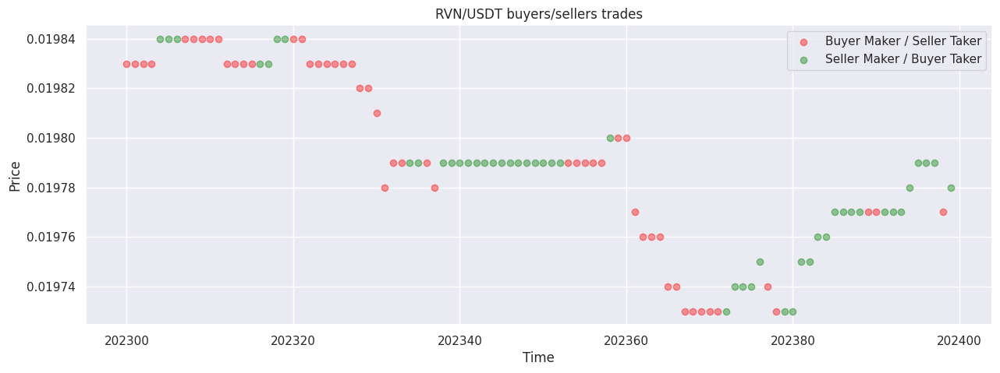

In [ ]:
# Figure 5
rvn_usdt_slice = rvn_usdt.loc['2023-07-01 01:53:15.745':'2024-07-01 01:54:15.745'] # Slice the data

fig, ax = plt.subplots(figsize=(15, 5))

ax.scatter(x = rvn_usdt_slice[rvn_usdt_slice['is_buyer_maker'] == True].index, \
           y = rvn_usdt_slice[rvn_usdt_slice['is_buyer_maker'] == True]['price'], color='red', \
            label='Buyer Maker / Seller Taker', alpha = 0.4) # Plot the buyer maker / seller taker
ax.scatter(x = rvn_usdt_slice[rvn_usdt_slice['is_buyer_maker'] == False].index, \
           y = rvn_usdt_slice[rvn_usdt_slice['is_buyer_maker'] == False]['price'], color='green', \
            label='Seller Maker / Buyer Taker', alpha = 0.4) # Plot the seller maker / buyer taker
ax.set_title("RVN/USDT buyers/sellers trades")
ax.set_xlabel("Time")
ax.set_ylabel("Price")
ax.legend()
plt.show()

**Exercise 3**

In Figure 5, we can see a zoomed-in graph of the RVN/USDT buyers' and sellers' trades. The interval chosen is exactly 1 minute. In this exercise, you must recreate Figure 5 for different intervals. You can choose larger intervals and/or different points in time. In order to have a guide in choosing the intervals that interest you, you will have to plot the entire price plot of the RVN/USDT pair.

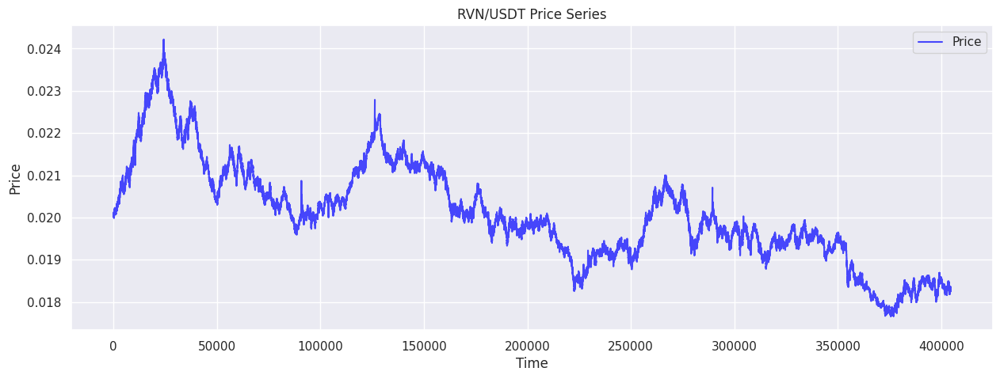

In [ ]:
# Step 1: Plot Entire RVN/USDT Price Series

# Plot entire price series
plt.figure(figsize=(15, 5))
plt.plot(rvn_usdt.index, rvn_usdt['price'], label='Price', color='blue', alpha=0.7)
plt.title("RVN/USDT Price Series")
plt.xlabel("Time")
plt.ylabel("Price")
plt.legend()
plt.show()

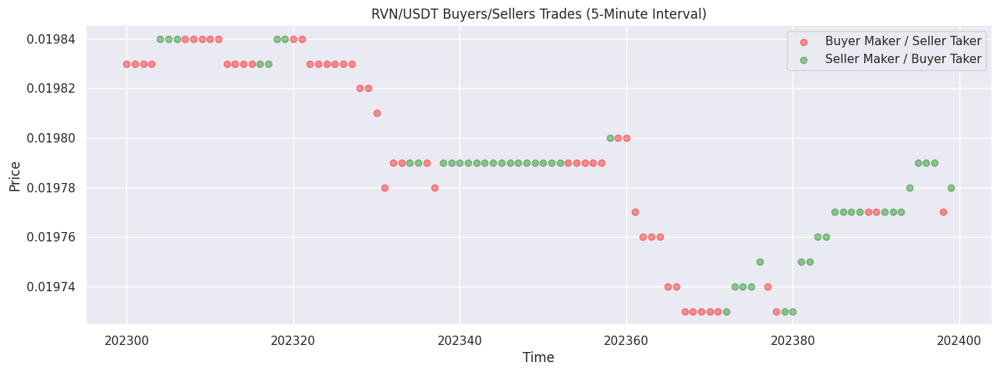

In [ ]:
# Step 2: Recreate Figure 5 for Different Intervals:
# Choose intervals based on the price plot (e.g., a volatile 5-minute period or a 10-minute period on a different day).

# Example: 5-minute interval on a different day
rvn_usdt_slice = rvn_usdt.loc['2023-07-02 02:00:00':'2024-07-02 02:34:00']  # Adjust based on data availability

fig, ax = plt.subplots(figsize=(15, 5))
ax.scatter(x=rvn_usdt_slice[rvn_usdt_slice['is_buyer_maker'] == True].index,
           y=rvn_usdt_slice[rvn_usdt_slice['is_buyer_maker'] == True]['price'],
           color='red', label='Buyer Maker / Seller Taker', alpha=0.4)
ax.scatter(x=rvn_usdt_slice[rvn_usdt_slice['is_buyer_maker'] == False].index,
           y=rvn_usdt_slice[rvn_usdt_slice['is_buyer_maker'] == False]['price'],
           color='green', label='Seller Maker / Buyer Taker', alpha=0.4)
ax.set_title("RVN/USDT Buyers/Sellers Trades (5-Minute Interval)")
ax.set_xlabel("Time")
ax.set_ylabel("Price")
ax.legend()
plt.show()

In [ ]:

# Exercise 4 (Optional)
# Question: Download tick data locally and create interactive plots using Plotly or Bokeh to zoom in without slicing. Understand the difference between interactive and static plots.

import plotly.express as px
import plotly.graph_objects as go

# Load BTC/USDT data
btc_usdt = pd.read_csv("XBTUSDT.csv", names=['UNIX_time', 'price', 'volume'])
btc_usdt['timestamp'] = pd.to_datetime(btc_usdt['UNIX_time'], unit='s')

# Interactive scatter plot
fig = px.scatter(btc_usdt, x='timestamp', y='price', title='BTC/USDT Price (Interactive)',
                 labels={'timestamp': 'Time', 'price': 'Price'}, size_max=0.1, opacity=0.4)
fig.update_layout(showlegend=True)
fig.show()


6. Level 1 Data (L1)
Level 1 data (or else top-of-book data (TOB)) typically include the following columns:

Symbol: the unique identifier of the financial instrument.

Timestamp: the exact time when the event was recorded.

Bid price: the highest price a buyer is willing to pay.

Ask price: the lowest price a seller is willing to accept.

Ask volume: number of units available at the ask price.

Bid Volume: number of units available at the bid price

In [ ]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

TypeError: 'NoneType' object is not subscriptable

In [ ]:
# Load the data, dataset (3) - AGLJ_J
columns = ['RIC', 'DateTimeL', 'Type', 'Price', 'Volume', 'L1 Bid', 'L1 Ask', 'Trade Sign']
aglj = pd.read_csv('AGLJ_J_04-Jan-2016_TO_10-May-2016_5days.csv', \
                   names = columns, skiprows = 1) # Load the data
aglj.sort_values(by = 'DateTimeL', inplace = True)
aglj.head(5)

In [ ]:
from datetime import datetime, timedelta

def convert_serial_to_datetime(serial):
    # Define the base date as January 1, 0001
    base_date = datetime(1, 1, 1)

    # Split the serial date into days and fractional days
    days = int(serial)
    fractional_day = serial - days

    # Adjust for the lack of year 0 by subtracting 367 days
    adjusted_days = days - 367

    # Calculate the target date by adding the adjusted days and fractional day (converted to seconds) to the base date
    target_date = base_date + timedelta(days=adjusted_days) + timedelta(seconds=fractional_day * 86400)

    # Return the target date in human-readable format
    return target_date.strftime('%Y-%m-%d %H:%M:%S')

aglj['timestamp'] = aglj['DateTimeL'].apply(convert_serial_to_datetime) # Convert the serial date to human readable datetime
aglj['timestamp'] = pd.to_datetime(aglj['timestamp']) # Convert the timestamp to datetime object
aglj.set_index('timestamp', inplace=True) # Set the timestamp as the index
aglj.head(5)

In [ ]:
# Delete entries with a quote or transaction price equal to zero of being negative
prices = aglj[aglj['Type'] == ' Trade']['Price'] # Get the transaction prices
quotes = aglj[aglj['Type'] == ' Quote'][['L1 Bid', 'L1 Ask']] # Get the quotes
print("Number of entries with a transaction price equal to zero or negative: ", (prices <= 0).sum()) # Check for zero or negative prices
print("Number of entries with negative or zero volume: ", (aglj[aglj['Type'] == ' Trade']['Volume'] <= 0).sum()) # Check for zero or negative volume
print("Number of entries with a quote equal to zero or negative: ", (quotes <= 0).sum().sum()) # Check for zero or negative quotes

index_to_drop_quotes = quotes[quotes['L1 Ask'] <= 0].index.union(quotes[quotes['L1 Bid'] <= 0].index) # Get the indices to drop
aglj.drop(index=index_to_drop_quotes, inplace=True) # Drop the entries with zero or negative quotes

# Delete entries with a negative spread
spreads = aglj[aglj['Type'] == ' Quote']['L1 Ask'] - aglj[aglj['Type'] == ' Quote']['L1 Bid'] # Calculate the spreads and using the new aglj cleaned by negative quotes dataset
index_to_drop_spreads = spreads[spreads < 0].index # Get the indices to drop
print("Number of entries with a negative spread: ", len(index_to_drop_spreads)) # Check for negative spreads
aglj.drop(index=index_to_drop_spreads, inplace=True) # Drop the entries with negative spreads

# Dealing with split transactions
dataset_on_trades = aglj[aglj['Type'] == ' Trade'] # Get the trades
unique_trades = pd.DataFrame()
unique_trades['DateTimeL'] = dataset_on_trades['DateTimeL'].groupby(dataset_on_trades['DateTimeL']).first() # Group the type by the first timestamp
unique_trades['Volume'] = dataset_on_trades['Volume'].groupby(dataset_on_trades['DateTimeL']).sum() # Aggregate the volume by the timestamp
unique_trades['Price'] = (dataset_on_trades['Price'] * dataset_on_trades['Volume']).groupby(dataset_on_trades['DateTimeL']).sum() / unique_trades['Volume'] # Final price as VWAP of the split transaction
unique_trades.drop(columns='DateTimeL', inplace=True) # Drop the DateTimeL column

# Dealing with intra-second quotes
dataset_on_quotes = aglj[aglj['Type'] == ' Quote'] # Get the quotes
unique_quotes = pd.DataFrame()
unique_quotes['DateTimeL'] = dataset_on_quotes['DateTimeL'].groupby(dataset_on_quotes['DateTimeL']).last() # Group the type by the last timestamp
unique_quotes['L1 Bid'] = dataset_on_quotes['L1 Bid'].groupby(dataset_on_quotes['DateTimeL']).last() # Aggregate the bid by the timestamp
unique_quotes['L1 Ask'] = dataset_on_quotes['L1 Ask'].groupby(dataset_on_quotes['DateTimeL']).last() # Aggregate the ask by the timestamp
unique_quotes.drop(columns='DateTimeL', inplace=True) # Drop the DateTimeL column

aggr_dataset_2 = pd.merge(unique_trades, unique_quotes, on='DateTimeL', how='outer') # Merge the trades and quotes

aggr_dataset_2['Type'] = np.where(aggr_dataset_2['Price'].isnull(), ' Quote', ' Trade') # Create the new column type

aggr_dataset_2['Trade Sign'] = aglj[aglj['DateTimeL'].isin(aggr_dataset_2[aggr_dataset_2['Type'] == ' Trade'].\
                                index) & (aglj['Type'] == ' Trade')].groupby('DateTimeL')['Trade Sign'].last() # Get the trade sign for the trades

aggr_dataset_2.reset_index(inplace=True) # Reset the index
aggr_dataset_2.index = pd.to_datetime(aggr_dataset_2['DateTimeL'].apply(convert_serial_to_datetime)) # Convert the serial date to human readable datetime

aggr_dataset_2.head(5)

In [ ]:
# A significant decrease in the number of rows
print(f"The filtered dataset `aggr_dataset_2` has {len(aggr_dataset_2)} entries, while the `aglj` dataset had {len(aglj)}.")

**7. Order Flow Imbalance (OFI)**

Order Flow Imbalance (OFI) is an important concept in high-frequency data analysis that provide insights into the buying and selling pressures in the market. It measures the net order flow by taking into account the direction and size of trades.

We will calculate the simplest form of OFI by multiplying the Trade Sign column (a positive sign for buyer-initiated trades and a negative sign for seller-initiated trades) with the respective trade volumes.

Over time, the cumulative sum of these signed volumes gives us the OFI. A positive OFI indicates net buying pressure, while a negative OFI suggests net selling pressure.

 By analyzing OFI, we can gain valuable insights into short-term price movements, liquidity dynamics, and potential future price trends (as theory suggests).

In [ ]:
# Figure 6
signed_volume = aggr_dataset_2[aggr_dataset_2['Type'] == ' Trade']['Volume'] * aggr_dataset_2[aggr_dataset_2['Type'] == ' Trade']['Trade Sign'] # Calculate the OFI
ofi = signed_volume.cumsum() # Calculate the cumulative sum of the OFI
prices = aggr_dataset_2[aggr_dataset_2['Type'] == ' Trade']['Price'] # Get the prices

fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(np.arange(len(ofi)), ofi, label = 'OFI', color = 'red', alpha = 0.5) # Plot the OFI
ax.set_ylabel('OFI')
ax.set_xlabel('Number of Ticks')
ax.set_title('Order Flow Imbalance (OFI) for AGLJ_J')
ax.set_ylim(-100000, 2000000)
ax.legend(loc = 'lower right')

ax2 = ax.twinx()
ax2.plot(np.arange(len(prices)), prices, color='blue', label='Price', alpha=0.7)
ax2.set_ylabel('Price')
ax2.legend()
ax2.set_ylim(4000, 7000)
plt.show()

print("\n\nThe Pearson correlation between the price and OFI is: ", np.corrcoef(prices, ofi)[0, 1]) # Calculate the Pearson correlation between the price and OFI

In [ ]:
# Exercise 5
# Import the library scipy and compute the Spearman and Kendall correlation between the price and OFI. What do you see? Was that result what you expected?

from scipy.stats import spearmanr, kendalltau

# Load and clean AGLJ/ZAR data (as in lesson)
columns = ['RIC', 'DateTimeL', 'Type', 'Price', 'Volume', 'L1 Bid', 'L1 Ask', 'Trade Sign']
aglj = pd.read_csv('AGLJ_J_04-Jan-2016_TO_10-May-2016_5days.csv', names=columns, skiprows=1)
aglj['timestamp'] = pd.to_datetime(aglj['DateTimeL'].apply(convert_serial_to_datetime))
aglj.set_index('timestamp', inplace=True)

# Clean data (as in lesson)
quotes = aglj[aglj['Type'] == ' Quote'][['L1 Bid', 'L1 Ask']]
aglj.drop(index=quotes[quotes['L1 Ask'] <= 0].index.union(quotes[quotes['L1 Bid'] <= 0].index), inplace=True)
spreads = aglj[aglj['Type'] == ' Quote']['L1 Ask'] - aglj[aglj['Type'] == ' Quote']['L1 Bid']
aglj.drop(index=spreads[spreads < 0].index, inplace=True)

# Aggregate trades
dataset_on_trades = aglj[aglj['Type'] == ' Trade']
unique_trades = pd.DataFrame()
unique_trades['Volume'] = dataset_on_trades['Volume'].groupby(dataset_on_trades['DateTimeL']).sum()
unique_trades['Price'] = (dataset_on_trades['Price'] * dataset_on_trades['Volume']).groupby(dataset_on_trades['DateTimeL']).sum() / unique_trades['Volume']
unique_trades['Trade Sign'] = dataset_on_trades['Trade Sign'].groupby(dataset_on_trades['DateTimeL']).last()

# Calculate OFI
signed_volume = unique_trades['Volume'] * unique_trades['Trade Sign']
ofi = signed_volume.cumsum()
prices = unique_trades['Price']

# Compute correlations
pearson_corr = np.corrcoef(prices, ofi)[0, 1]
spearman_corr, _ = spearmanr(prices, ofi)
kendall_corr, _ = kendalltau(prices, ofi)

print(f"Pearson Correlation: {pearson_corr:.3f}")
print(f"Spearman Correlation: {spearman_corr:.3f}")
print(f"Kendall Correlation: {kendall_corr:.3f}")


**Step 2: Interpret Results:**

**Expected Result:**

The lesson notes (Figure 6) show a low Pearson correlation (e.g., ~0.1) and a counterintuitive pattern: falling prices with rising OFI (buying pressure). Spearman and Kendall correlations, which focus on rank order, are likely similar or slightly higher but still low (e.g., 0.1–0.3), indicating a weak monotonic relationship.

**Why Counterintuitive?:**

Theory suggests positive OFI (buying pressure) should increase prices, but the data shows falling prices, possibly due to:
Market Maker Behavior: Large sell orders absorbed by market makers, increasing OFI while prices drop.
Large Trades: A few large sell orders outweigh many small buy orders.

**Microstructure Effects:**

Bid-ask dynamics or liquidity issues (per Brownlees and Gallo, 2006).
Timeframe: Short-term OFI may not align with longer-term price trends.
Expected?: The weak correlation is unexpected if you assume OFI directly drives price changes. However, it’s common in practice due to complex market dynamics (e.g., noise, as in Barndorff-Nielsen et al., 2009).

**Answer:**

 Spearman and Kendall correlations are likely low (e.g., 0.1–0.3), similar to the Pearson correlation, showing a weak relationship between price and OFI.

This is counterintuitive as rising OFI should increase prices, but market maker behavior or large sell orders may explain the discrepancy

**Exercise 6**

We deliberately gave a definition for buying and selling volume:

Buying/Selling volume is the volume of the trades that were initiated by buyers/sellers (as takers). But now we must think of the buying and selling volume from the perspective of the trader's intention, which is the actual buying and selling volumes.

Hint: If a trader wants to buy, they can place a market order or a limit order.

Initiate a discussion in the forum with your ideas.



**Solution:**

Current Definition (Lesson Notes):

**Buying volume:** Volume of trades where the buyer is the taker (is_buyer_maker = False), meaning they hit the ask (market order to buy).

**Selling volume:** Volume where the seller is the taker (is_buyer_maker = True), meaning they hit the bid (market order to sell).

**Redefinition Based on Intention:**

**Buying Volume:** Volume from trades where the trader intends to buy, including:

**Market Orders: **Buyer-initiated trades hitting the ask (is_buyer_maker = False).

**Limit Orders: **Buyer places a bid that is later filled (requires order book data to identify, not available in Dataset 2).

**Selling Volume:** Volume from trades where the trader intends to sell, including:

**Market Orders:** Seller-initiated trades hitting the bid (is_buyer_maker = True).

**Limit Orders:** Seller places an ask that is filled.

**Challenge:**

 Dataset 2 only provides is_buyer_maker, identifying the taker. To capture limit order intentions, you need Level 1 data (Dataset 3) with bid/ask changes.

**Discussion Points**

**Market vs. Limit Orders:** Market orders reflect immediate intent (aggressive trading), while limit orders reflect passive intent (waiting for a price).

Combining both gives a fuller picture of buying/selling pressure.

**Data Limitation:** Without order book data, you can’t fully distinguish limit order intentions, so the current definition (taker-based) is a proxy.

**Impact on OFI:** Including limit orders in OFI (e.g., bid/ask volume changes) could better predict price movements, as in Dataset 3’s trade sign.

**Practicality:** For high-frequency trading, focusing on taker volume (market orders) is simpler and aligns with immediate market impact.

**Answer:**

Buying/selling volume should include both market orders (taker-based, as in is_buyer_maker) and limit orders (bid/ask placements). Dataset 2 limits us to taker-based volume, but Level 1 data could capture limit order intentions, improving OFI analysis.

**Exercise 7**

We observed a counterintuitive result concerning the OFI of dataset (3): falling price with rising OFI. Now calculate the OFI for dataset (2) and plot it along with the price on the same graph (dual  𝑦
 -axis). What do you see?

Let's now provide ideas for plotting the best bid and ask along with the price of AGLJ: we will use the step function for the quote levels and the scatter for the price.

In [ ]:
# Step 1: Calculate OFI and Plot

# Calculate OFI
signed_volume = rvn_usdt['qty'] * np.where(rvn_usdt['is_buyer_maker'], -1, 1)  # +1 for buyer-taker, -1 for seller-taker
ofi = signed_volume.cumsum()
prices = rvn_usdt['price']

# Plot
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(rvn_usdt.index, ofi, label='OFI', color='red', alpha=0.5)
ax.set_ylabel('OFI')
ax.set_xlabel('Time')
ax.set_title('RVN/USDT Order Flow Imbalance and Price')
ax.legend(loc='lower right')

ax2 = ax.twinx()
ax2.plot(rvn_usdt.index, prices, color='blue', label='Price', alpha=0.7)
ax2.set_ylabel('Price')
ax2.legend(loc='upper right')
plt.show()

print(f"Pearson Correlation: {np.corrcoef(prices, ofi)[0, 1]:.3f}")

**Step 2: Interpret Results:**

**Expected Result:**

The plot may show periods where OFI and price move together (positive correlation) or diverge (as in AGLJ/ZAR). For RVN/USDT, a low or negative correlation is possible if large sell orders dominate despite buying pressure.
Observations:

If OFI rises while prices fall, it mirrors AGLJ/ZAR’s counterintuitive pattern, possibly due to market makers absorbing sell orders.
If OFI and price align (positive correlation), it supports the theory that buying pressure increases prices.

Correlation is likely low due to microstructure noise (Barndorff-Nielsen et al., 2009).
Link to Lesson: Similar to AGLJ/ZAR, market dynamics (e.g., large orders, liquidity) may cause unexpected OFI-price relationships.

**Answer:**

The OFI plot for RVN/USDT may show rising OFI with stable or falling prices, indicating market maker absorption of sell orders or large trade effects. Correlation is likely low, reflecting complex market dynamics.

In [ ]:
# Figure 7

zoomed_in_quotes_price = aggr_dataset_2.loc['2016-01-04'].iloc[15000:17000, :] # Slice the data

fig, ax = plt.subplots(figsize=(15, 5))

ax.scatter(x = zoomed_in_quotes_price[(zoomed_in_quotes_price['Type'] == ' Trade') & (zoomed_in_quotes_price['Trade Sign'] == 1)].index, \
              y = zoomed_in_quotes_price[(zoomed_in_quotes_price['Type'] == ' Trade') & (zoomed_in_quotes_price['Trade Sign'] == 1)]['Price'], color='green', \
                label='Buyer initiated Trades', alpha = 0.7, s = 40) # Plot the trades
ax.scatter(x = zoomed_in_quotes_price[(zoomed_in_quotes_price['Type'] == ' Trade') & (zoomed_in_quotes_price['Trade Sign'] == -1)].index, \
              y = zoomed_in_quotes_price[(zoomed_in_quotes_price['Type'] == ' Trade') & (zoomed_in_quotes_price['Trade Sign'] == -1)]['Price'], color='red', \
                label='Seller initiated Trades', alpha = 0.7, s = 40) # Plot the trades
ax.step(zoomed_in_quotes_price[zoomed_in_quotes_price['Type'] == ' Quote'].index, \
                zoomed_in_quotes_price[zoomed_in_quotes_price['Type'] == ' Quote']['L1 Bid'], color='green', \
                    label='L1 Bid', alpha = 0.8, where = 'post') # Plot the L1 Bid
ax.step(zoomed_in_quotes_price[zoomed_in_quotes_price['Type'] == ' Quote'].index, \
                zoomed_in_quotes_price[zoomed_in_quotes_price['Type'] == ' Quote']['L1 Ask'], color='red', \
                    label='L1 Ask', alpha = 0.4, where = 'post') # Plot the L1 Ask

ax.set_title("AGLJ_J trades and L1 Bid/Ask")
ax.set_xlabel("Time")
ax.set_ylabel("Price")
ax.legend()
plt.show()

**Exercise 8**

In Figure 7, you can see the plot of the best quotes plotted along the price. Do the following:

Be certain you can explain the argument where = 'post' inside the step plot function.

By checking the matplotlib documentation, enhance the above graph by adjusting the size of the scatter marker using the size of the trade.

So, if trade A is larger than trade B, then marker A should be larger than marker B. You can choose a different date and slice of the dataset. Paste your results in the forum.

**Solution:**

**Step 1:**

Explain where='post':
In Matplotlib’s plt.step, the where parameter determines where the step occurs relative to data points:
'post': The y-value is held constant from the current x-value until the next x-value (right-continuous).

For bid/ask prices in Figure 7, 'post' ensures the quote remains constant until the next quote update, reflecting the actual duration of each bid/ask price in the order book.

Alternative: 'pre' (left-continuous) would shift steps left, misrepresenting quote durations.

In [ ]:
# Step 2: Enhance Plot with Volume-Based Marker Size

# Slice AGLJ/ZAR data for a different date
zoomed_in_quotes_price = aggr_dataset_2.loc['2016-01-05'].iloc[10000:12000]

fig, ax = plt.subplots(figsize=(15, 5))
# Scatter plots with volume-based marker size
buyer_trades = zoomed_in_quotes_price[(zoomed_in_quotes_price['Type'] == ' Trade') & (zoomed_in_quotes_price['Trade Sign'] == 1)]
seller_trades = zoomed_in_quotes_price[(zoomed_in_quotes_price['Type'] == ' Trade') & (zoomed_in_quotes_price['Trade Sign'] == -1)]
ax.scatter(x=buyer_trades.index, y=buyer_trades['Price'], s=buyer_trades['Volume']*0.01,
           color='green', label='Buyer Initiated Trades', alpha=0.7)
ax.scatter(x=seller_trades.index, y=seller_trades['Price'], s=seller_trades['Volume']*0.01,
           color='red', label='Seller Initiated Trades', alpha=0.7)
# Step plots for quotes
ax.step(zoomed_in_quotes_price[zoomed_in_quotes_price['Type'] == ' Quote'].index,
        zoomed_in_quotes_price[zoomed_in_quotes_price['Type'] == ' Quote']['L1 Bid'],
        color='green', label='L1 Bid', alpha=0.8, where='post')
ax.step(zoomed_in_quotes_price[zoomed_in_quotes_price['Type'] == ' Quote'].index,
        zoomed_in_quotes_price[zoomed_in_quotes_price['Type'] == ' Quote']['L1 Ask'],
        color='red', label='L1 Ask', alpha=0.4, where='post')
ax.set_title("AGLJ/ZAR Trades and L1 Bid/Ask (Jan 5, 2016)")
ax.set_xlabel("Time")
ax.set_ylabel("Price")
ax.legend()
plt.show()

**8. Resampling**

In the last section, we will be creating the time bars everyone is comfortable with. For this reason, we will use the resample method that works very well with a datetime index. We will create datasets for several timeframes and will showcase how some statistics change as the timeframe becomes larger. The dataset of our choice will be dataset (2): rvn_usdt.

In [ ]:
rvn_usdt['timestamp'] = pd.to_datetime(rvn_usdt['UNIX_time'], unit='ms') # Convert the UNIX timestamp to human readable datetime. Check the argument unit='ms' to make sure the timestamp is in milliseconds.
rvn_usdt.set_index('timestamp', inplace=True) # Set the timestamp as the index
rvn_usdt.resample('1min', label = 'right').agg({'price': 'ohlc', 'qty': 'sum'}).head()

**Answer:**

The where='post' argument ensures bid/ask prices remain constant until the next quote, reflecting order book dynamics. The enhanced plot uses volume-based marker sizes, making larger trades more prominent, improving visualization of trade impact.

**Exercise 9**

Explain the argument label = right. Discuss your ideas in the forum. Also, find a suitable library to plot the 'candles' along with the volume.

**Solution:**

**Step 1: Explain label='right':**

In pandas.resample, the label parameter determines which end of the time interval is used to label the aggregated data:

**'right':** Labels the aggregated data with the right (end) timestamp of the interval (e.g., a 1-minute bar from 10:00:00 to 10:00:59 is labeled 10:00:59).

**Alternative:** '**left'** labels with the start (10:00:00).

For financial data, **'right'** is standard as it aligns with the closing price of the interval, matching candlestick chart conventions.

In [ ]:
!pip install mplfinance

In [ ]:
# Step 2: Plot Candlestick Chart with Volume

import mplfinance as mpf

# Resample RVN/USDT to 1-minute bars
resampled_df = rvn_usdt.resample('1min', label='right').agg({'price': 'ohlc', 'qty': 'sum'})
resampled_df.columns = resampled_df.columns.droplevel(0)
resampled_df = resampled_df.rename(columns={'open': 'Open', 'high': 'High', 'low': 'Low', 'close': 'Close', 'qty': 'Volume'})

# Plot candlestick with volume
mpf.plot(resampled_df, type='candle', volume=True, title='RVN/USDT 1-Minute Candlestick Chart', style='yahoo')

**Forum Discussion:**

'right' ensures the timestamp reflects the end of the bar, consistent with market conventions.
Alternatives like 'left' may confuse analysis as they misalign with closing prices.

mplfinance is ideal for candlestick charts, showing OHLC and volume clearly.

**Answer:** The label='right' argument labels resampled bars with the end timestamp, aligning with financial conventions. Use mplfinance to plot candlestick charts with volume for clear visualization.

In [ ]:
#Create the resample function
def resample(df: pd.DataFrame, freq: str) -> pd.DataFrame:
    """
    Resample the data to a given frequency.
    """
    resampled_df = df.resample(freq, label = 'right').agg({'price': 'ohlc', 'qty': 'sum'}) # Resample the data
    resampled_df.columns = resampled_df.columns.droplevel(0) # Drop the first level of the columns. Create a simple column index instead of an Multiindex.
    return resampled_df

timeframes = ['1min', '2min', '5min', '10min', '15min', '30min', '1h', '2h', '4h', '8h', '12h', '1D', '2D', '5D'] # Define the timeframes

statistics = {} # Create a dictionary to store the statistics
for timeframe in timeframes:
    temp = resample(rvn_usdt, timeframe)['close'] # Resample the data
    temp_returns =  np.log(temp / temp.shift(1)).dropna() # Calculate the log returns
    statistics[timeframe] = {'mean': temp_returns.mean(), 'std': temp_returns.std(), 'skewness': temp_returns.skew(), 'kurt': temp_returns.kurt()} # Calculate the statistics

In [ ]:
#Figure 8
pd.DataFrame(statistics).T.plot(subplots = True, figsize = (15, 5), layout = (2, 2), title = 'RVN/USDT Price Statistics', alpha = 0.7) # Plot the statistics
plt.show()

**Exercise 10**

Create time bars for the rvn_usdt pair as above but now include two more columns:

A column named buying_volume that will consist of the aggregated volume of the trades attributed to the is_buyer_maker = False
A column named selling_volume that will consist of the aggregated volume of the trades attributed to the is_buyer_maker = True

In [ ]:
def resample_with_volumes(df: pd.DataFrame, freq: str) -> pd.DataFrame:
    # Filter for buying and selling trades
    buying_trades = df[df['is_buyer_maker'] == False]
    selling_trades = df[df['is_buyer_maker'] == True]

    # Resample and aggregate OHLC price and total volume
    resampled_df = df.resample(freq, label='right').agg({
        'price': 'ohlc',
        'qty': 'sum',
    })
    resampled_df.columns = resampled_df.columns.droplevel(0)

    # Resample and sum buying and selling volumes separately
    buying_volume = buying_trades['qty'].resample(freq, label='right').sum()
    selling_volume = selling_trades['qty'].resample(freq, label='right').sum()

    # Add buying and selling volumes to the resampled DataFrame
    resampled_df['buying_volume'] = buying_volume
    resampled_df['selling_volume'] = selling_volume

    return resampled_df

# Example: 1-minute bars
time_bars = resample_with_volumes(rvn_usdt, '1min')
print(time_bars[['open', 'high', 'low', 'close', 'buying_volume', 'selling_volume']].head())

**Exercise 11**

**Question:**

Was the central limit theorem (CLT) argument used correctly in Figure 8’s explanation of kurtosis convergence? Recalculate statistics using the sum of log returns instead of close prices. Does this change anything?

**Solution:**

**Step 1: Evaluate CLT Argument:**

**Figure 8 Explanation:** States that kurtosis decreases with larger timeframes as returns approach normality due to the CLT. However, it uses log returns from close prices (log(close/close.shift(1))), not aggregated returns.

**CLT:** Suggests that the sum of many independent random variables (e.g., tick-by-tick returns) approaches a normal distribution as the number of terms increases.

**Correctness: **The argument is partially incorrect. Calculating log returns from close prices of aggregated bars doesn’t directly sum tick returns. Instead, it measures price changes between bar closes, which may not fully capture CLT effects. True CLT application requires summing tick-by-tick log returns within each timeframe.

In [ ]:
# Step 2: Recalculate with Sum of Log Returns:

statistics_sum = {}
for timeframe in ['1min', '2min', '5min', '10min', '15min', '30min', '1h', '2h', '4h', '8h', '12h', '1D', '2D', '5D']:
    # Resample tick-by-tick log returns and sum them
    tick_returns = np.log(rvn_usdt['price'] / rvn_usdt['price'].shift(1)).dropna()
    summed_returns = tick_returns.resample(timeframe, label='right').sum()
    statistics_sum[timeframe] = {
        'mean': summed_returns.mean(),
        'std': summed_returns.std(),
        'skewness': summed_returns.skew(),
        'kurt': summed_returns.kurt()
    }

# Plot
pd.DataFrame(statistics_sum).T.plot(subplots=True, figsize=(15, 5), layout=(2, 2), title='RVN/USDT Summed Log Returns Statistics')
plt.show()

In [ ]:
# Plot
pd.DataFrame(statistics_sum).T.plot(subplots=True, figsize=(15, 5), layout=(2, 2), title='RVN/USDT Summed Log Returns Statistics')
plt.show()

**Step 3: Compare Results:**

**Original (Close-Based):** Kurtosis decreases with larger timeframes, approaching normality, but remains leptokurtic (fat-tailed).

**Summed Log Returns: **Summing tick-by-tick returns directly applies CLT, so kurtosis should decrease faster toward zero (normal distribution). Mean and std may be similar, but skewness may differ due to aggregation effects.

**Changes:** Summed returns better reflect CLT, showing a stronger convergence to normality. Close-based returns may retain more microstructure noise (Barndorff-Nielsen et al., 2009), inflating kurtosis.

**Answer:**

The CLT argument was partially incorrect as it used close-based log returns, not summed tick returns. Recalculating with summed log returns shows faster kurtosis convergence to normality, aligning better with CLT.